# Projeto 14: Deep Dream

Codificação adaptada da documentação do TensorFlow: https://www.tensorflow.org/beta/tutorials/generative/deepdream

Mais informações sobre a rede InceptionV3:https://cloud.google.com/tpu/docs/inception-v3-advanced?hl=pt-br

# Introdução a rede InceptionV3
> O Inception v3 é um modelo de reconhecimento de imagem que foi mostrado para alcançar mais de 78,1% de precisão no conjunto de dados do ImageNet. Esse modelo é o auge de muitas ideias desenvolvidas por vários pesquisadores ao longo dos anos. Ele é baseado no documento original["Rethinking the Inception Architecture for Computer Vision"](https://arxiv.org/abs/1512.00567) de Szegedy e outros autores. - Google
 
>O próprio modelo é composto de elementos básicos simétricos e assimétricos, incluindo convoluções, average pooling ,max pooling, concatenações, dropouts e camadas totalmente conectadas. A batch normalization é usada extensivamente em todo o modelo e aplicada às entradas de ativação. A perda é calculada usando Softmax. - Google

![inceptionV3](https://cloud.google.com/tpu/docs/images/inceptionv3onc--oview.png)

# Introdução a DeepDream

>DeepDream é um programa de visão computacional criado pelo engenheiro do Google Alexander Mordvintsev que usa uma rede neural convolucional para encontrar e aprimorar padrões em imagens via pareidolia algorítmica , criando assim uma aparência de sonho que lembra uma experiência psicodélica nas imagens deliberadamente superprocessadas. - Wikipédia

Após o treinamento da rede InceptionV3 a rede é executada ao contrário sendo solicitado a ajustar ligeiramente aimagem original
para que um determinado neurônio de saída (por exemplo, o de rostos ou certos animais) produza uma pontuação de confiança mais
alta (subida do gradiente).

# Gradient descent Vs Gradient ascent

## Gradient descent

Gradient descent é um método comum para otimização dos parâmetros de um modelo de machine learning, é o método mais tipico
para **minimização de uma função de custo.**
Sua principal limitação é sua convergência garantida para um mínimo local e não necessariamente global, tal limitação pode ou não ser ultrapassada com o uso de uma taxa de aprendizado adequada 

![função do gradiente](https://cdn.discordapp.com/attachments/567172861509369877/987069365365145610/unknown.png)

>α = taxa de aprendizado,
w =  pesos,
f =  função,

![graph gradiente](https://cdn.discordapp.com/attachments/567172861509369877/987070071174234172/unknown.png)

**Gradiente ascent tem o papel inverso da gradiente descent, enquanto um minimiza uma função o outro maximiza a função**

![gradiente ascent formula](https://cdn.discordapp.com/attachments/212373606355828738/987071257835085834/unknown.png)

Se a descida do gradiente indica um movimento iterativo em direção ao mínimo mais próximo, a subida do gradiente, inversamente, indica um movimento em direção ao máximo mais próximo. Nesse sentido, para qualquer função fna qual aplicamos gradiente descendente, existe uma função simétrica na qual podemos aplicar gradiente ascendente -f

Isso significa também que um problema resolvido através de gradiente descendente também tem soluções que podemos encontrar através de gradiente ascendente, se apenas o refletirmos sobre o eixo da variável independente . Esta imagem mostra a mesma função do gráfico anterior, mas refletida ao longo do xeixo:

![subida gradiente](https://cdn.discordapp.com/attachments/212373606355828738/987071909009166357/unknown.png)

# Etapa 1: Importação das bibliotecas

In [ ]:
#!pip uninstall numpy
#!pip install numpy==1.19.5

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
print(tf.__version__)
print(np.__version__)

2.8.2
1.19.5


Esse código foi projetado na versão 1.19.5 do numpy 

# Etapa 2: Importação do modelo com pesos pré-treinados

A maioria dos modelos são uma série de camadas convolucionais seguidas por uma ou algumas camadas densas (ou totalmente conectadas).

*Include_top* permite selecionar se deseja ou não as camadas densas finais.

- As camadas convolucionais funcionam como extratores de recursos. Eles identificam uma série de padrões na imagem, e cada camada pode identificar padrões mais elaborados vendo padrões de padrões.

- As camadas densas são capazes de interpretar os padrões encontrados para classificar: esta imagem contém gatos, cães, carros, etc.

In [ ]:
#top =  false para não ter as camadas de saida
base_model = tf.keras.applications.InceptionV3(include_top = False,
                                              weights = 'imagenet')

In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

# Nota:
- O objetivo do algoritmo é selecionar uma camada para maximizar a loss function, que são as ativações
- Podemos selecionar qualquer camada, lembrando que as primeiras camadas possuem características mais simples (bordas) e camadas superiores possuem características mais complexas e detalhadas dos objetos
- A rede Inception possui múltiplas camadas concatenadas chamadas de 'mixed' 

In [ ]:
#escolha das camadas
#names = ['mixed8', 'mixed9']
#names = ['mixed3', 'mixed5', 'mixed8', 'mixed9']
#names = ['mixed3', 'mixed5']
names = ['mixed1', 'mixed2','mixed4']


In [ ]:
layers = [base_model.get_layer(name).output for name in names]

In [ ]:
layers

[<KerasTensor: shape=(None, None, None, 288) dtype=float32 (created by layer 'mixed1')>,
 <KerasTensor: shape=(None, None, None, 288) dtype=float32 (created by layer 'mixed2')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed4')>]

In [ ]:
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

# Etapa 3: Processar uma imagem

In [ ]:
sample_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))

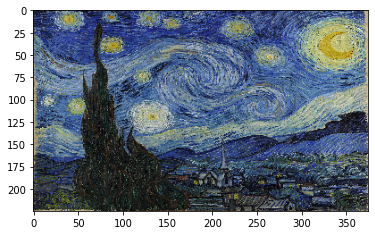

In [ ]:
plt.imshow(sample_image)

In [ ]:
type(sample_image)

PIL.Image.Image

In [ ]:
#normalização
sample_image = np.array(sample_image) / 255.0
sample_image.shape

(225, 375, 3)

In [ ]:
type(sample_image)

numpy.ndarray

In [ ]:
sample_image.max()

1.0

In [ ]:
sample_image.min()

0.0

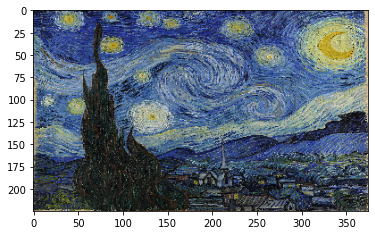

In [ ]:
plt.imshow(sample_image)

# Etapa 4: Executar o modelo pré-treinado e explorar as ativações

In [ ]:
sample_image = tf.keras.preprocessing.image.img_to_array(sample_image)
sample_image.shape

(225, 375, 3)

In [ ]:
type(sample_image)

numpy.ndarray

In [ ]:
sample_image = tf.Variable(tf.keras.applications.inception_v3.preprocess_input(sample_image))

In [ ]:
type(sample_image)

tensorflow.python.ops.resource_variable_ops.ResourceVariable

In [ ]:
sample_image = tf.expand_dims(sample_image, axis = 0)
np.shape(sample_image)

TensorShape([1, 225, 375, 3])

In [ ]:
sample_image.shape

TensorShape([1, 225, 375, 3])

In [ ]:
activations = deepdream_model(sample_image)

In [ ]:
len(activations)

3

In [ ]:
activations[0]

<tf.Tensor: shape=(1, 25, 44, 288), dtype=float32, numpy=
array([[[[1.4376099 , 2.6678905 , 0.9214912 , ..., 0.        ,
          0.        , 1.9740988 ],
         [1.5846473 , 1.2462953 , 1.990424  , ..., 0.        ,
          0.        , 1.7548895 ],
         [1.4362508 , 1.1809722 , 1.1199282 , ..., 0.        ,
          0.        , 1.1434301 ],
         ...,
         [1.4406804 , 1.0442721 , 1.3044969 , ..., 0.        ,
          0.        , 0.58025   ],
         [1.5884315 , 1.1083515 , 1.1651298 , ..., 0.        ,
          0.        , 1.2311856 ],
         [1.6824046 , 1.6035098 , 1.1483396 , ..., 0.        ,
          0.00623733, 1.5542881 ]],

        [[1.3344649 , 1.0328815 , 2.0070214 , ..., 0.        ,
          0.        , 1.8828853 ],
         [0.7625775 , 0.        , 2.3494463 , ..., 0.        ,
          0.        , 1.6662816 ],
         [0.8657608 , 0.        , 1.6202615 , ..., 0.        ,
          0.14433558, 0.9731798 ],
         ...,
         [0.78196156, 0.      

# Etapa 5: Cálculo da loss

- Calcularemos a loss que representa o somatório das ativações de uma camada específica
- Na maioria das vezes o objetivo é minizar o erro (loss) usando a descida gradiente, porém, em deep dream o objetivo é maximizar a loss 
- Isso é feito usando subida do gradiente (gradient ascent)
- A função encaminha a imagem pela rede neural e gera as ativações. Depois obtemos a soma das saídas
 

In [ ]:
def calc_loss(image, model, test = 1):
  if test == 1:
    img_batch = tf.expand_dims(image, axis = 0)
    layer_activations = model(img_batch)
  else:
    layer_activations = model(image)

  losses = []
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  print('Losses from multiple activation layers = ', losses)
  print('Losses shape = ', np.shape(losses))
  print('Sum of all losses = ', tf.reduce_sum(losses))

  return tf.reduce_sum(losses)

In [ ]:
loss = calc_loss(sample_image, deepdream_model, test = 0)
loss

Losses from multiple activation layers =  [<tf.Tensor: shape=(), dtype=float32, numpy=0.5143567>, <tf.Tensor: shape=(), dtype=float32, numpy=0.31011704>, <tf.Tensor: shape=(), dtype=float32, numpy=0.14485295>]
Losses shape =  (3,)
Sum of all losses =  tf.Tensor(0.9693267, shape=(), dtype=float32)


<tf.Tensor: shape=(), dtype=float32, numpy=0.9693267>

# Etapa 6: Subida do gradiente

- Vamos utilizar a loss calculada no passo anterior e calcular o gradiente com respeito a imagem de entrada. Depois adicionamos os valores na imagem de entrada


In [ ]:
@tf.function
def deepdream(model, image, step_size):
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss = calc_loss(image, model)

  gradients = tape.gradient(loss, image)
  gradients /= tf.math.reduce_std(gradients)
  image = image + gradients * step_size
  image = tf.clip_by_value(image, -1, 1)

  return loss, image

In [ ]:

def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01): 
  # stepzise =  learning rate
  image = tf.keras.applications.inception_v3.preprocess_input(image)
  for step in range(steps):
    loss, image = deepdream(model, image, step_size)

    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print('Step {}, loss {}'.format(step, loss))
  
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [ ]:
def deprocess(image):
  image = 255 * (image + 1.0) / 2.0
  return tf.cast(image, tf.uint8)

# Etapa 7: Primeiro teste

In [ ]:
test_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))
test_image = np.array(test_image)
#test_image = tf.keras.applications.inception_v3.preprocess_input(test_image)

In [ ]:
np.shape(test_image)

(225, 375, 3)

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses shape =  (3,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


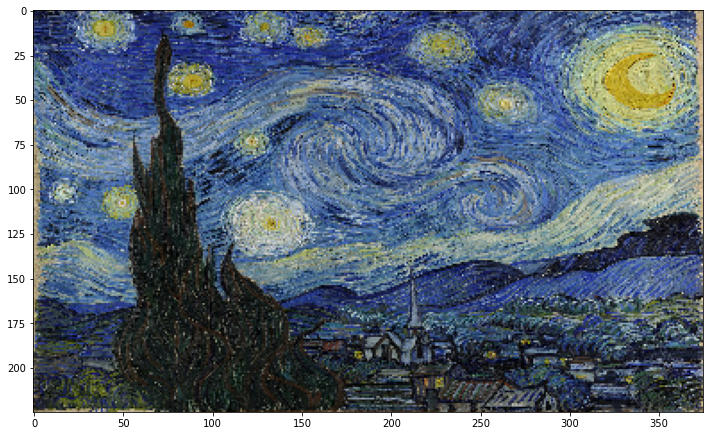

Step 0, loss 0.9907112121582031


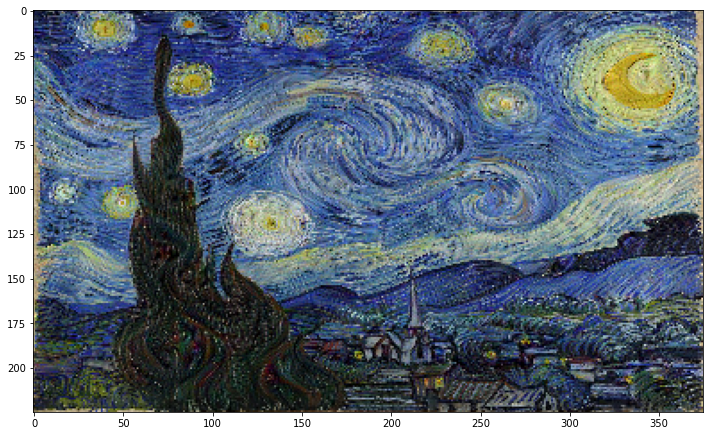

Step 100, loss 1.7450792789459229


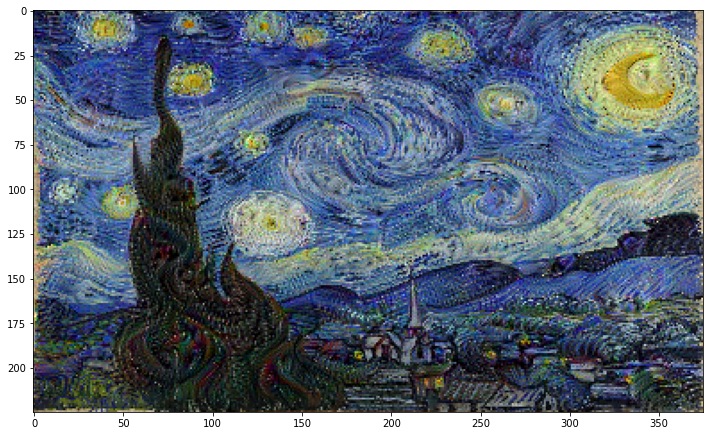

Step 200, loss 2.079796314239502


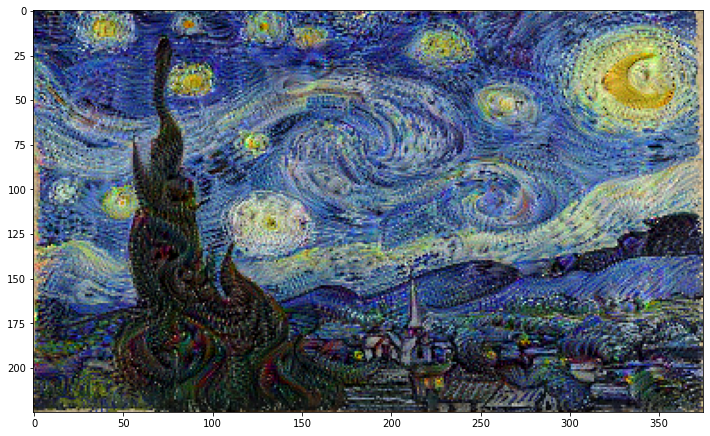

Step 300, loss 2.2919952869415283


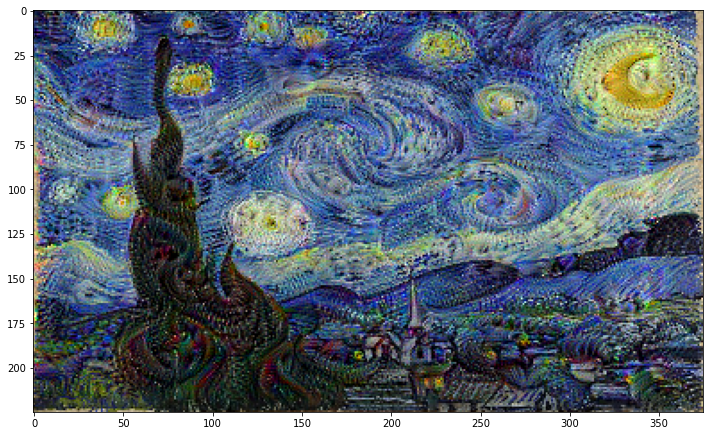

Step 400, loss 2.4524624347686768


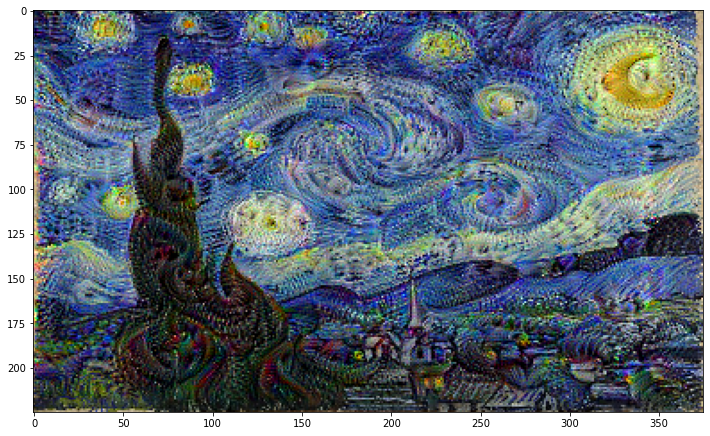

Step 500, loss 2.5874414443969727


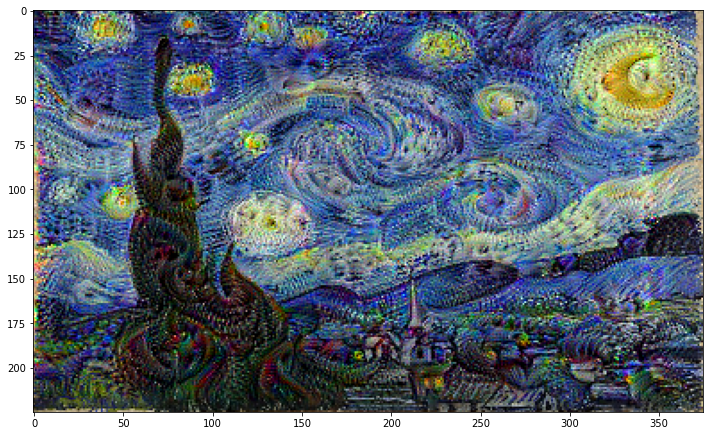

Step 600, loss 2.702338695526123


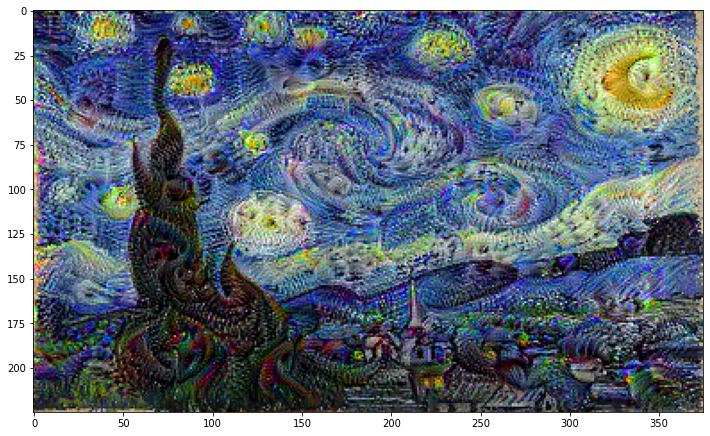

Step 700, loss 2.804976224899292


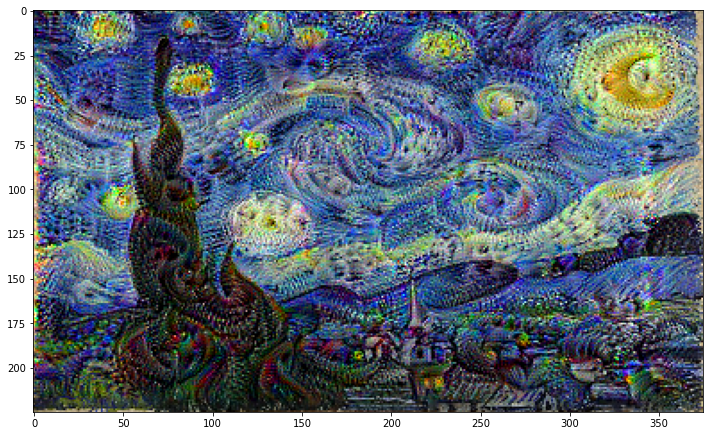

Step 800, loss 2.9026196002960205


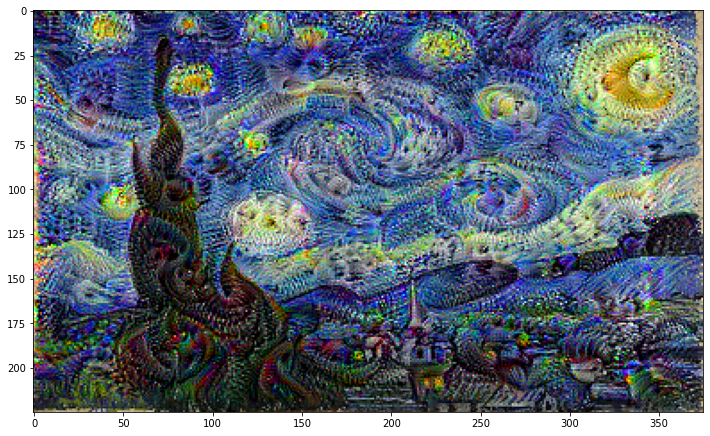

Step 900, loss 2.9968090057373047


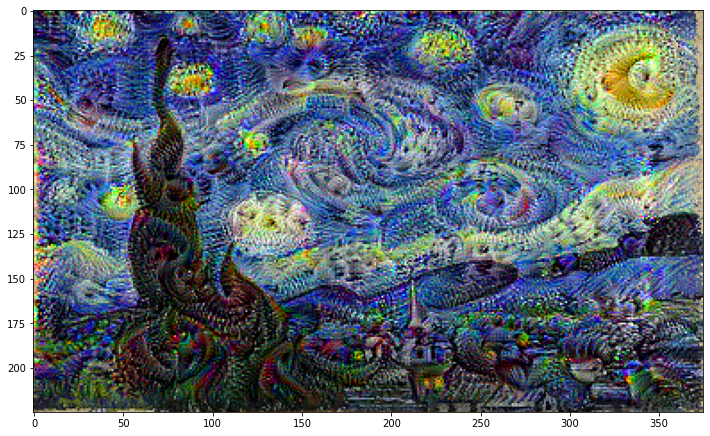

Step 1000, loss 3.084702968597412


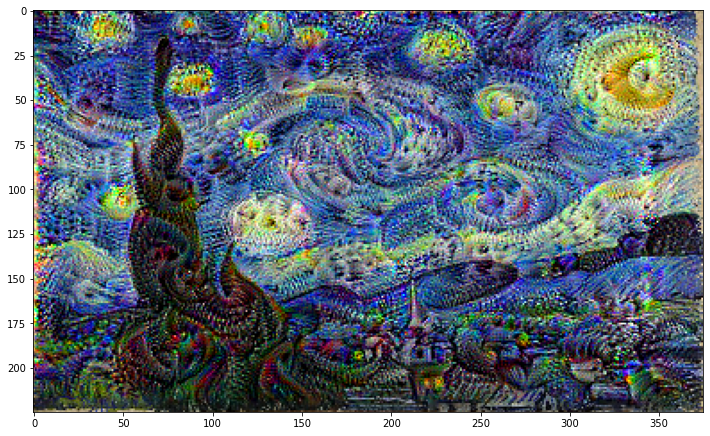

Step 1100, loss 3.169264316558838


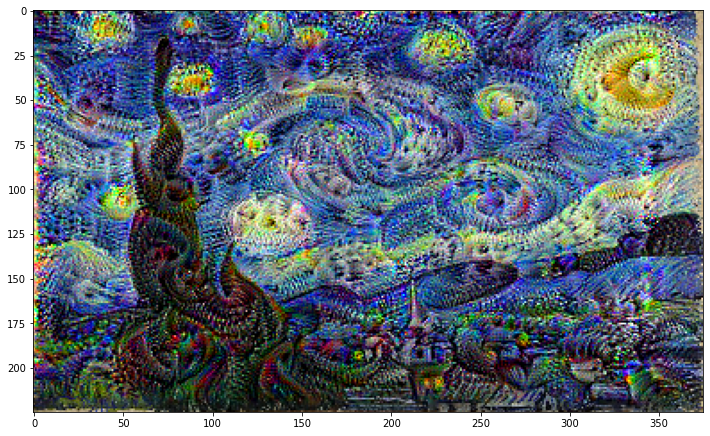

Step 1200, loss 3.251638650894165


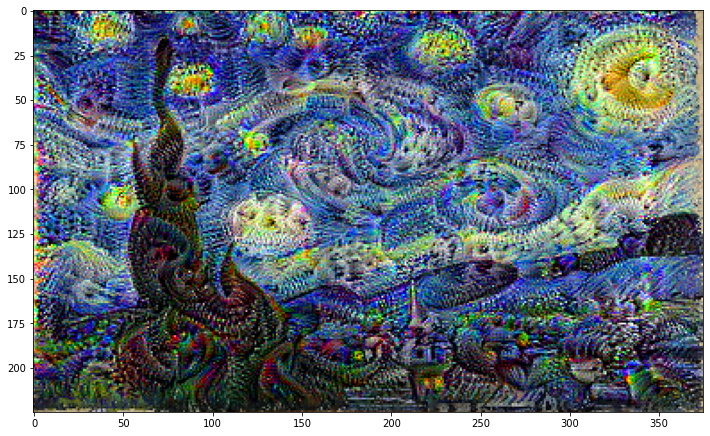

Step 1300, loss 3.331528425216675


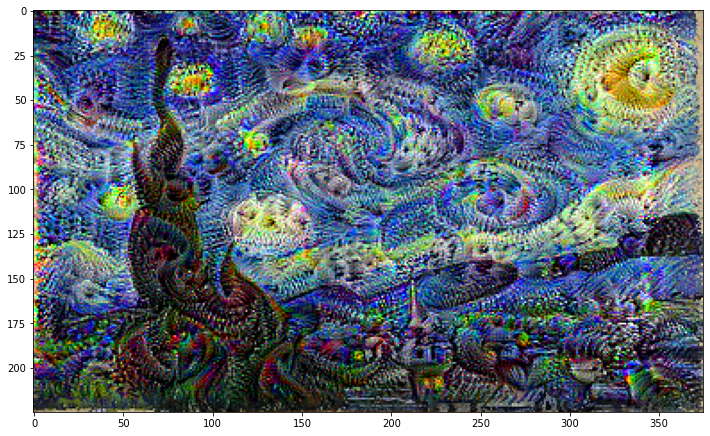

Step 1400, loss 3.4099552631378174


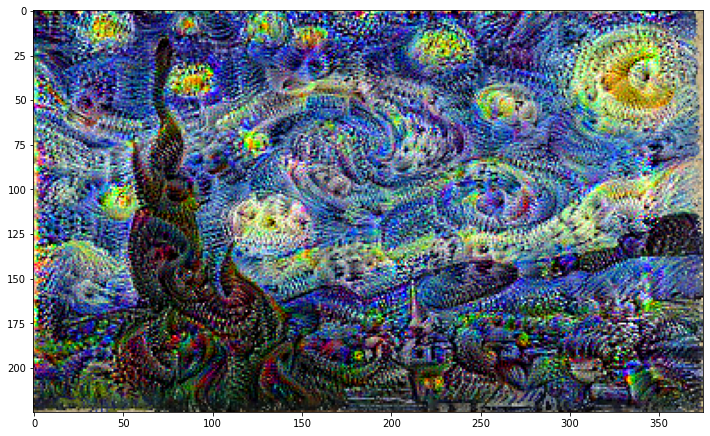

Step 1500, loss 3.4837214946746826


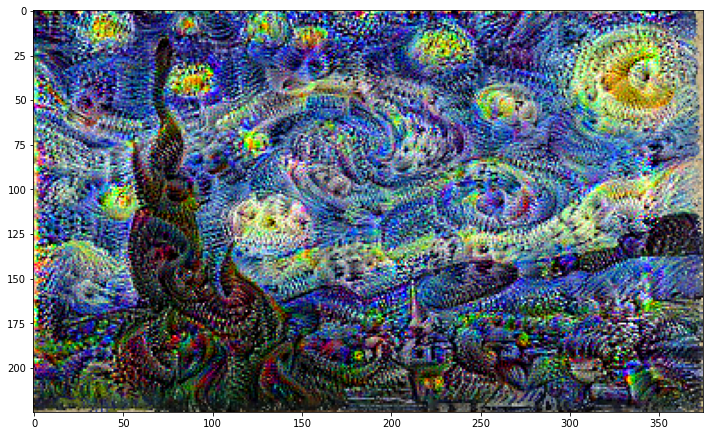

Step 1600, loss 3.554380416870117


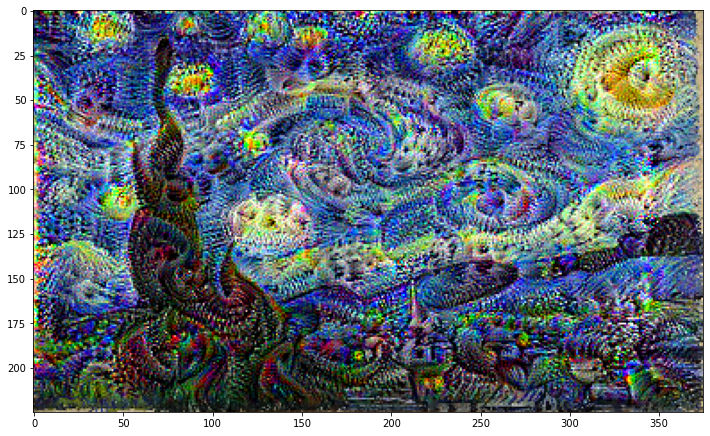

Step 1700, loss 3.6234374046325684


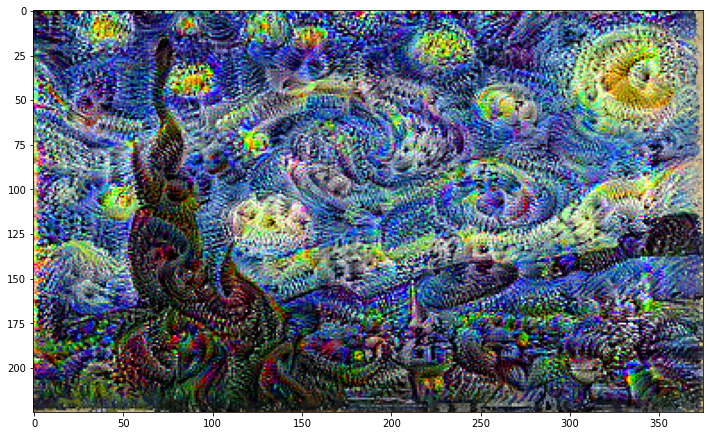

Step 1800, loss 3.689434051513672


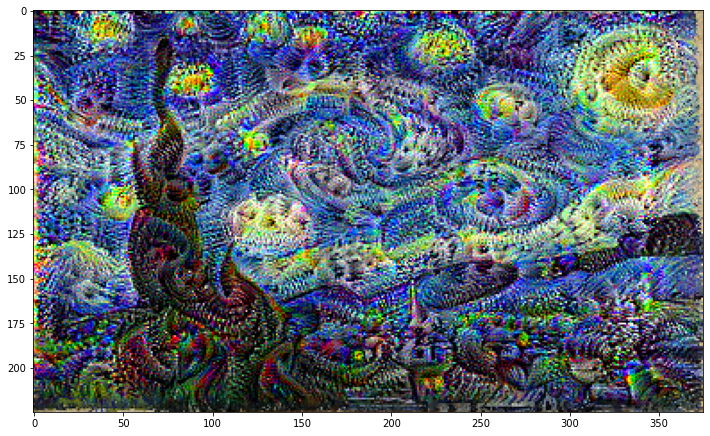

Step 1900, loss 3.7536673545837402


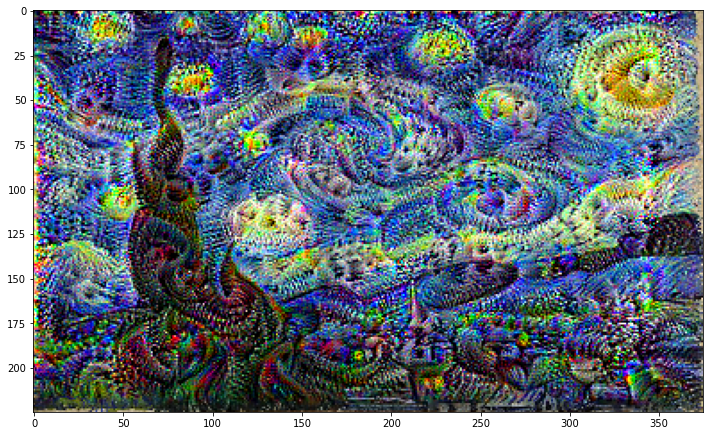

In [ ]:
dream_img = run_deep_dream_simple(model = deepdream_model, 
                                  image = test_image,
                                  steps = 2000, step_size = 0.001)

# Etapa 8: Executando em mais dimensões

In [ ]:
escala = 1.3
test_image2 = tf.keras.preprocessing.image.load_img(r'/content/sky.jpeg',
                                                     target_size = (225, 375))
#test_image2 = np.array(test_image2)
#test_image2 = tf.keras.applications.inception_v3.preprocess_input(test_image2)

image = tf.constant(np.array(test_image2))
base_shape = tf.cast(tf.shape(image)[:-1], tf.float32)

In [ ]:
type(image)

tensorflow.python.framework.ops.EagerTensor

In [ ]:
np.shape(image)

TensorShape([225, 375, 3])

In [ ]:
type(base_shape)

tensorflow.python.framework.ops.EagerTensor

In [ ]:
np.shape(base_shape)

TensorShape([2])

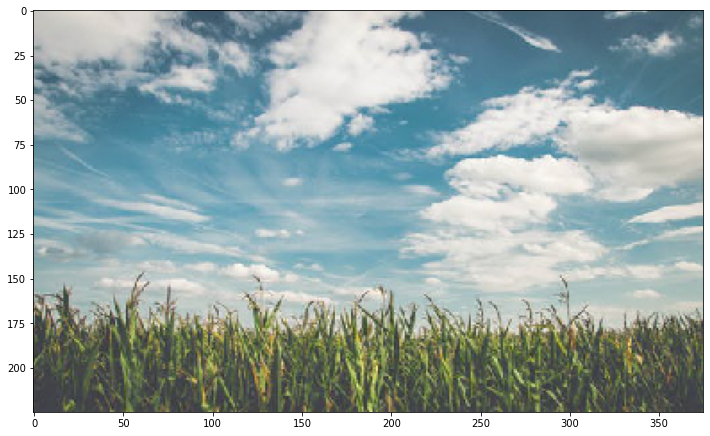

Step 0, loss 1.0011905431747437


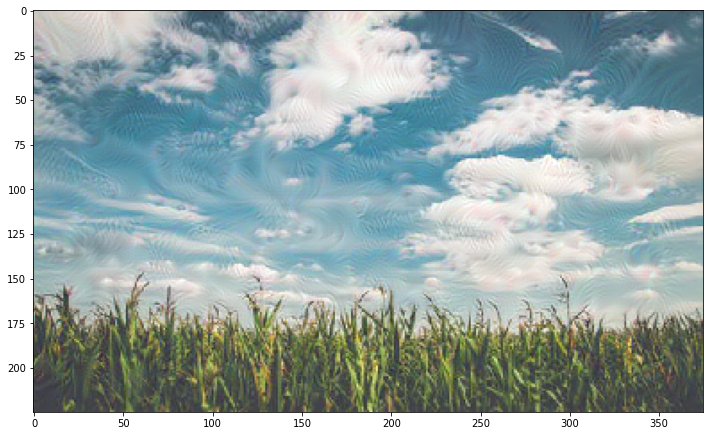

Step 100, loss 1.775376319885254


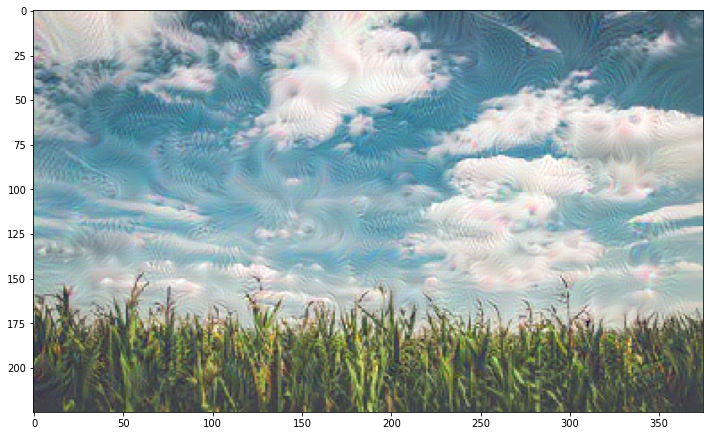

Step 200, loss 2.0342400074005127


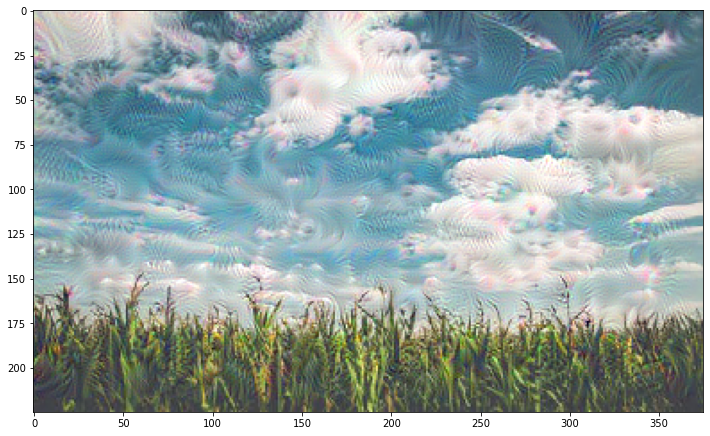

Step 300, loss 2.202617645263672


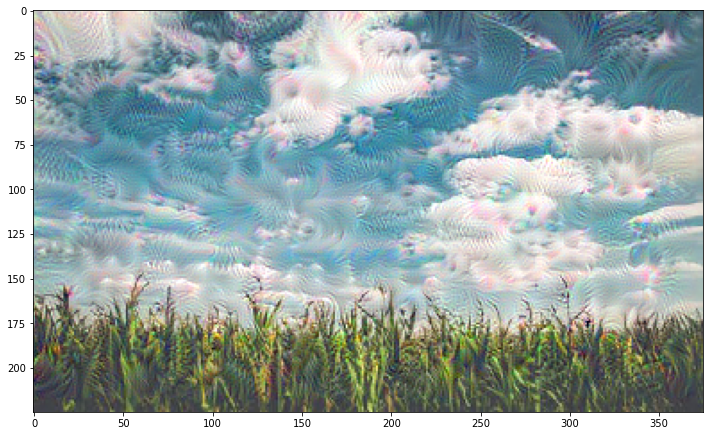

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses shape =  (3,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


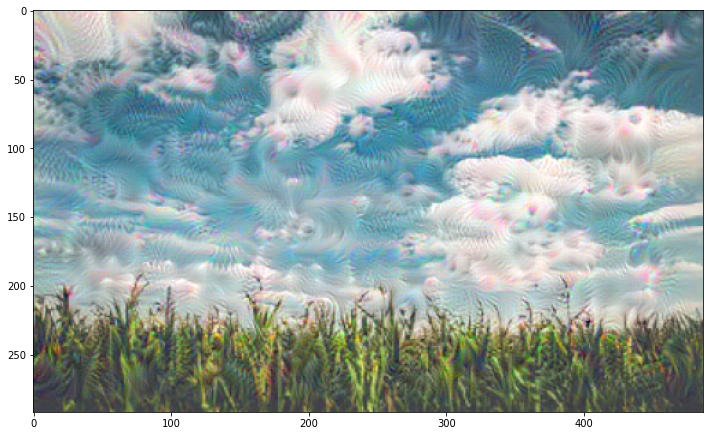

Step 0, loss 1.253131628036499


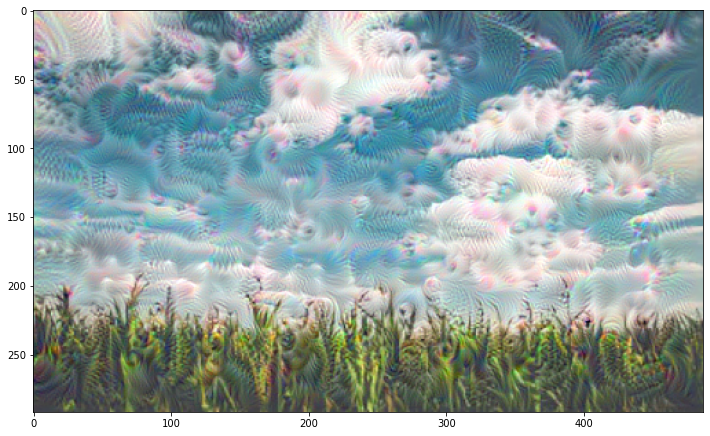

Step 100, loss 2.0381619930267334


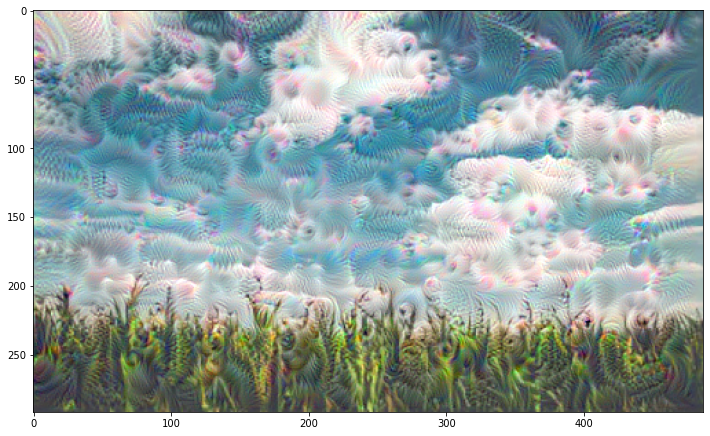

Step 200, loss 2.2544379234313965


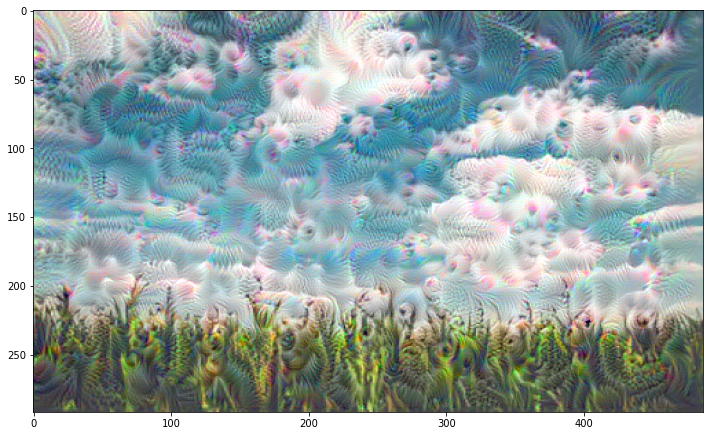

Step 300, loss 2.395721435546875


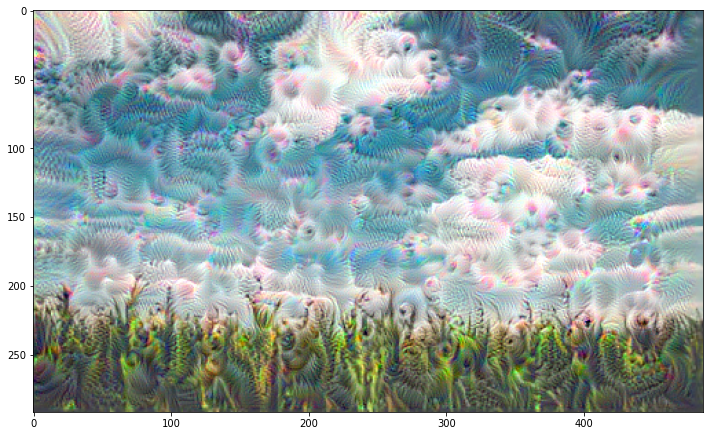

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses shape =  (3,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


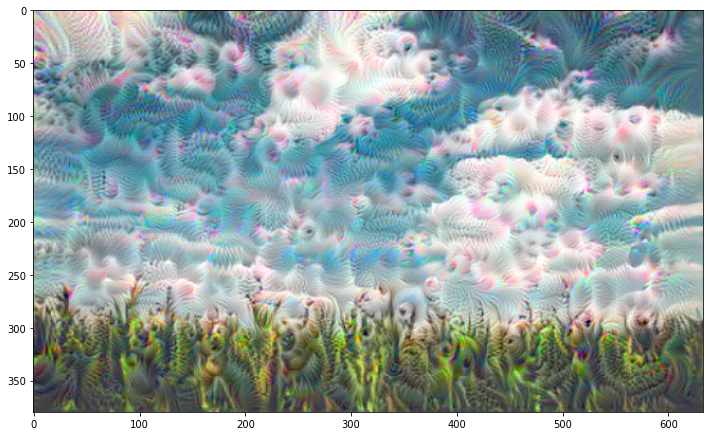

Step 0, loss 1.2819418907165527


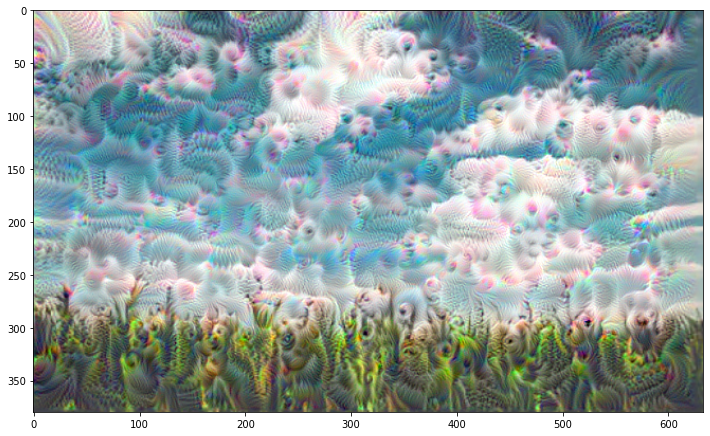

Step 100, loss 2.0899877548217773


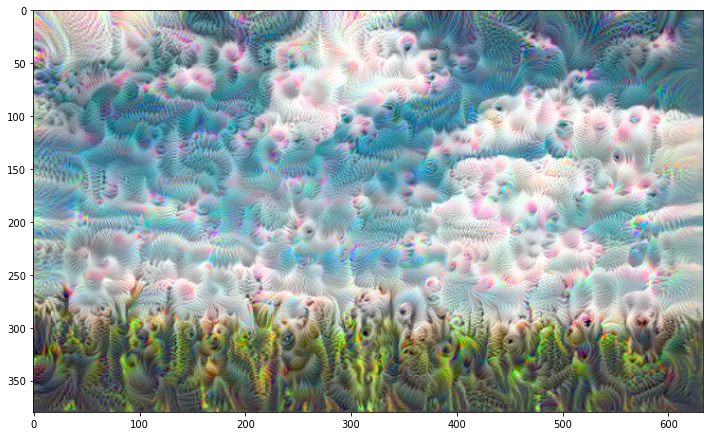

Step 200, loss 2.302000045776367


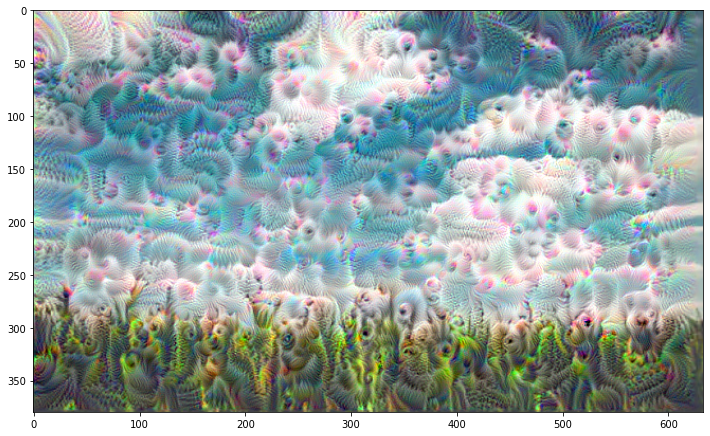

Step 300, loss 2.4360218048095703


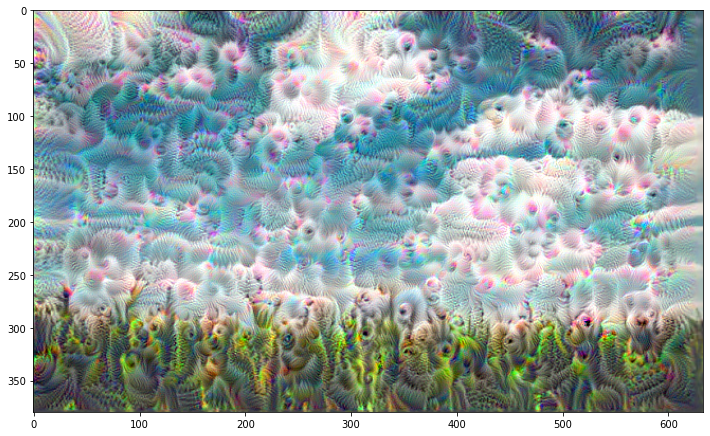

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses shape =  (3,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


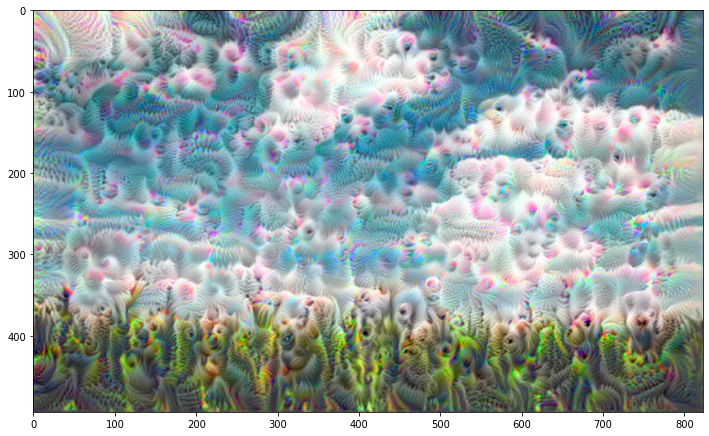

Step 0, loss 1.2685227394104004


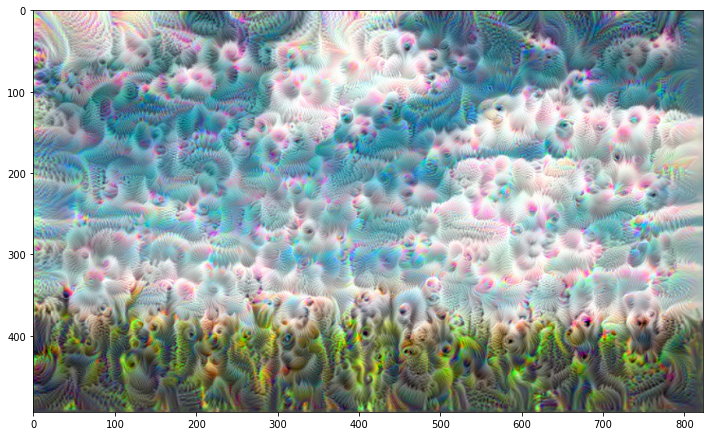

Step 100, loss 2.075657844543457


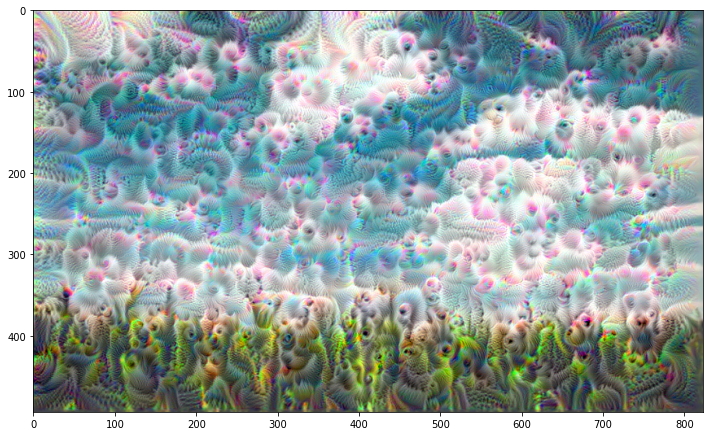

Step 200, loss 2.2845277786254883


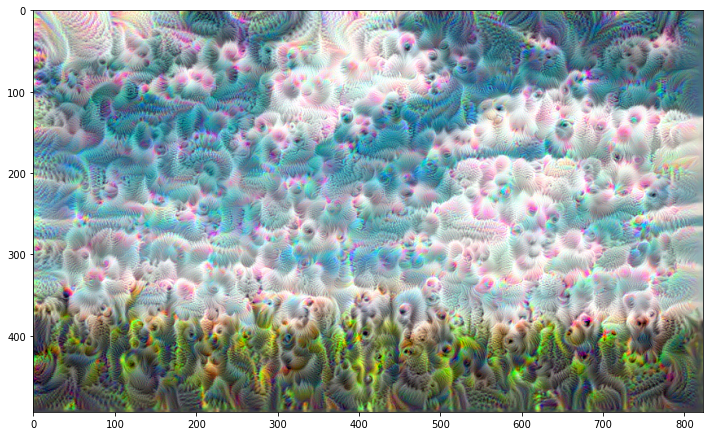

Step 300, loss 2.416015863418579


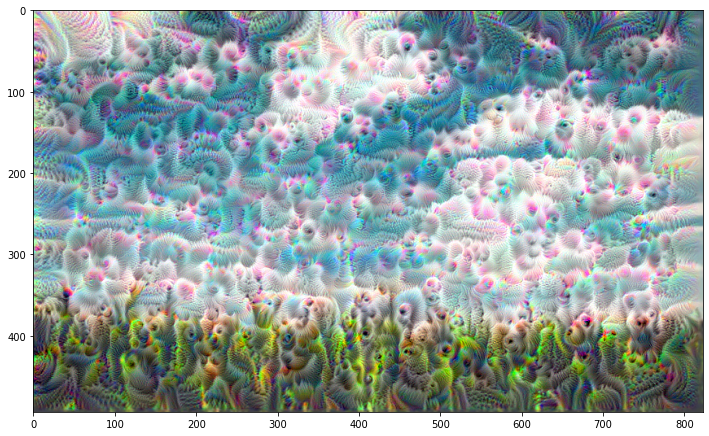

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>, <tf.Tensor 'Mean_2:0' shape=() dtype=float32>]
Losses shape =  (3,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


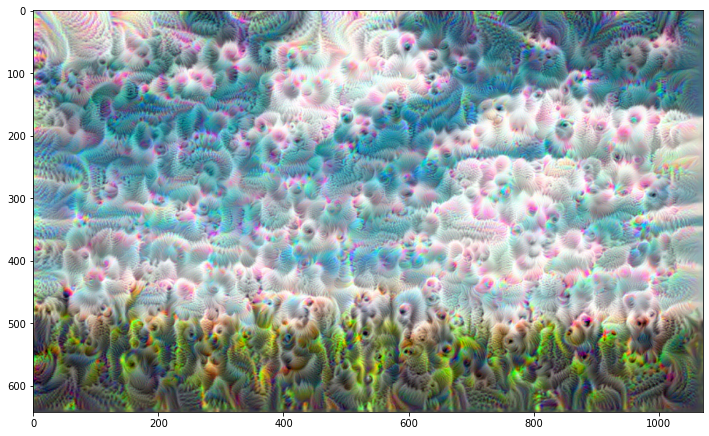

Step 0, loss 1.2636504173278809


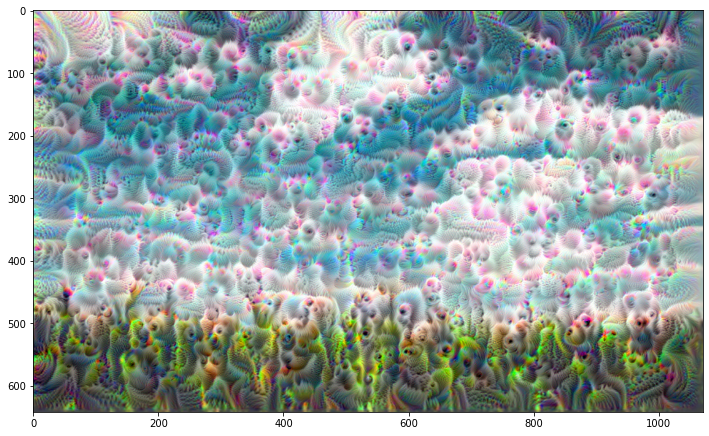

Step 100, loss 2.0691323280334473


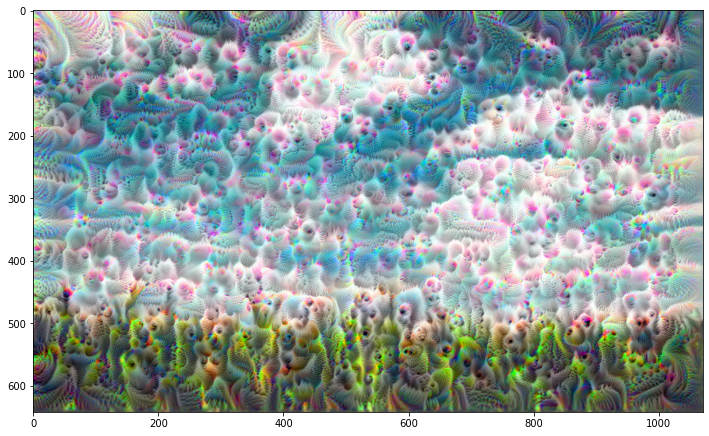

Step 200, loss 2.277892827987671


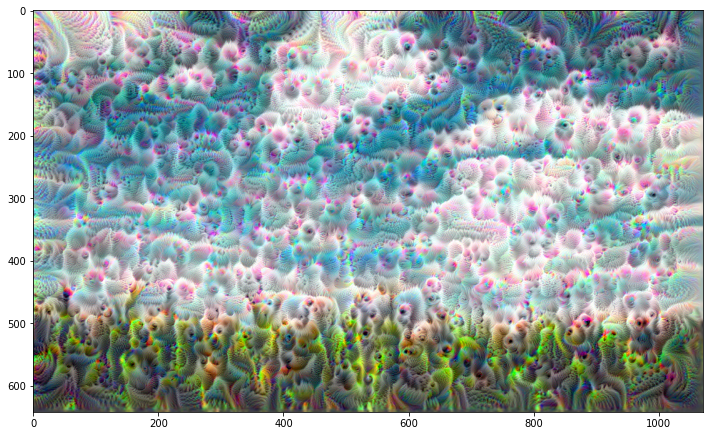

Step 300, loss 2.4092001914978027


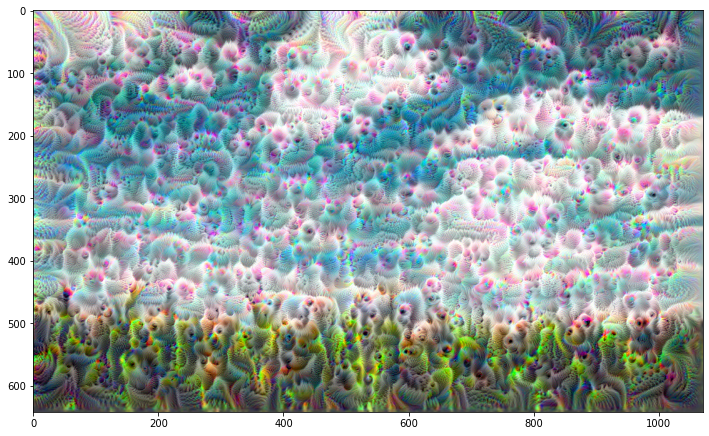

In [ ]:
for n in range(5):
  new_shape = tf.cast(base_shape * (escala**n), tf.int32)
  image = tf.image.resize(image, new_shape).numpy()
  image = run_deep_dream_simple(model=deepdream_model,image = image,
                                steps = 400, step_size = 0.001)

# Exemplos de redes diferentes

Como temos uma rede treinada para identificar diversos tipos de padrões o resultado acaba sendo alucinógeno contudo se tivessemos uma rede treinada para identificar padrões especificos o resultado seria diferente, a imagem abaixo foi gerada com uma rede treinada para identificar padrões da "Starry Night" de Van Gogh contudo foi passado a imagem do campo  que foi utilizada acima
![Rede treinada com starry night passando imagem do campo](https://cdn.discordapp.com/attachments/630900065547845633/987108956805689364/unknown.png)


**Mona lisa usando a rede** ***VGG16*** **treinada na ImageNet** 
![monalisaem vgg16](https://cdn.discordapp.com/attachments/567172861509369877/987116922392965211/unknown.png)

## Rede treianda para identificar cachorros
**Imagem original **
![original](https://upload.wikimedia.org/wikipedia/commons/thumb/f/f0/Aurelia-aurita-3_%28cropped%29.jpg/1280px-Aurelia-aurita-3_%28cropped%29.jpg)
**Imagem após 10 iterações **
![meio](https://upload.wikimedia.org/wikipedia/commons/8/89/Aurelia-aurita-3-0009.jpg)
**Imagem após  50 iterações **
![final](https://upload.wikimedia.org/wikipedia/commons/6/65/Aurelia-aurita-3-0049.jpg)

**Uma fotografia fortemente processada pelo DeepDream de três homens em uma piscina**
![man in pool](https://upload.wikimedia.org/wikipedia/commons/7/71/Deep_Dreamscope_%2819822170718%29.jpg)

Site para gerar imagens com a técnica deep dream 
https://deepdreamgenerator.com/